# Ontario's Sunshine List (1996-2020)

Project Group 2:

- William Conley - 100782574
- Reese Dominguez - 100775764
- Alex Sawatzky - 100790274
- Joshua Trower - 100791683

## Introduction

### The Ontario Public Sector Safety Disclosure/Sunshine List

The [Ontario Public Sector Safety Disclosure](https://www.ontario.ca/page/public-sector-salary-disclosure#section-1), henceforth referred to as the **Sunshine List** for this notebook, started its collection in 1996 as a result of the **Public Sector Salary Disclosure Act** passed by the Government of Ontario. This act requires public service organizations to submit staff and salary information for all staff that earn more than \$100,000 during a calendar year by March of the year after, so as to make this data available to the public and to make public service organizations accountable for the use of the province's funding.

Although this is a positive step when it comes to transparency in the government level, the data does not show basic demographics such as gender and race, especially after the passing of the [Anti-Racism Act in 2017](https://news.ontario.ca/en/release/44976/ontario-passes-anti-racism-legislation). We want to explore any discrepancies in equity in gender and race regarding the public sector's highest paid employees.

We start by answering these basic questions, and then answering any other questions that appear as a result:

1. Which sector has the most people/largest budget?
2. What proportion of Sunshine Listers are women?
3. What proportion of Sunshine Listers are racialized?
4. How much of a change has there been since 1996?
5. Are any sectors improving in their racial/gender representation?

## Description of Data

As the Sunshine List has already been described in the introduction, we take this opportunity to introduce our auxiliary/helper datasets. Note that this has been taken almost verbatim from the descriptions in our proposal:

#### World Gender Name Dictionary
Link: https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/MSEGSJ 

Citation: Raffo, Julio, 2021, "WGND 2.0", https://doi.org/10.7910/DVN/MSEGSJ, Harvard Dataverse, V1, UNF:6:5rI3h1mXzd6zkVhHurelLw== [fileUNF]

This data set is available on Harvard’s dataverse which is an archive of data that has been used in research and is made available for use by other researchers.  The data was compiled by Martinez, Lax, Raffo and Saito in 2016 as part of their research paper “Identifying the Gender of PCT Inventors.”  The author has compiled more than 26 million records and linked the given names from over 195 different countries and territories. Similar to the work of Raffo, this dataset will be used to explore the representation of women on the Sunshine List.  It is important to note that using a database of names to assign genders is an imprecise approach and in many cases may misattribute gender given how many names there are that are used by both genders (like Chris or Sam). However, since the sunshine list does not include gender in the datasets, it is hoped that this imprecise approach may still offer some value in the consideration of gender representation on the Sunshine list. This data has been made available as CCO – “Public Domain Dedication”.

#### Most Common Names Database
Link: https://raw.githubusercontent.com/fivethirtyeight/data/master/most-common-name/surnames.csv 

This data set is available on FiveThirtyEight's [Github (direct link)](https://github.com/fivethirtyeight/data/blob/master/most-common-name/). [FiveThirtyEight](https://fivethirtyeight.com/)  is a website devoted to using statistics to understand political, social and sporting trends.  The data is maintained by Andrew Flowers as part of the article “Dear Mona, What’s The Most Common Name in America?” article.  This data is a compilation of surnames from the US Census Bureau which includes the percentage of the population that identifies as White, Black, Asian, Hispanic and Multiple Races. It is important to note that determining racial identity solely by surname is an imprecise approach, given that each surname often has representation across all racial identities.  However, since the sunshine list does not include employee racial identity, it is hoped that this imprecise approach may still offer some value in consideration of the representative diversity on the Sunshine List.  This data has been made available under a Creative Commons Attribution 4.0 International License.

#### Ontario Demographics
Link: https://www12.statcan.gc.ca/census-recensement/2016/dp-pd/prof/details/Page.cfm?Lang=E&Geo1=PR&Code1=35&Geo2=&Code2=&Data=Count&SearchText=Ontario&Sear

This dataset is maintained by Statistics Canada and provides provincial and national statistics on population demographics.  This will serve as a baseline to compare proportions and see if a group is over or under represented. The latest census publically available is that for 2016, as 2021's will be available in February 2022.

---
---

## Analysis of Data

We first import all the datasets we intend to use. For the Sunshine List, since we're working with 24 years' worth of work, we concatenate them all into one dataframe.

In [1]:
#importing used libraries
import csv
import re
import pandas as pd
from functools import reduce
import numpy as np
import calendar
import string
import matplotlib.pyplot as plt
import random

# seaborn
import seaborn as sns

In [2]:
# dataset import preparation
data_path = 'datasets/'
# reads CSV file, returns data in Python dict
# thanks Mariana ^^;

# to anyone else working on this: modify as needed.
def get_data_csv(path):
    collection = []
    with open(path, 'r') as f:
        for line in csv.DictReader(f):
            collection.append(line)
        return collection

In [3]:
# dataset importing - sunshine lists

# because the "Salary Paid" column is formatted 
# differently for each list...
def format_sunshine(path):
    return (pd.DataFrame(get_data_csv(path))).rename(columns = {"Salary paid" : "Salary Paid",
                                                                "Salary Paid " : "Salary Paid",
                                                                "Surname": "Last Name",
                                                                "Last name": "Last Name",
                                                                "Position": "Job Title",
                                                                "Job title": "Job Title",
                                                                "Calendar year": "Calendar Year",
                                                                "First name": "First Name",
                                                                "Taxable benefits": "Taxable Benefits"})

# concatenating all into one df
df_sunshine = format_sunshine(data_path + 'sunshine1996.csv')
df_sunshine["Calendar Year"] = 1996

for yr in range(1997, 2021):
    # calling it a temp dataset because it'll be rewritten
    # w/ each loop
    curr_file = data_path + 'sunshine' + str(yr) + '.csv'
    df_temp = format_sunshine(curr_file)
    df_temp["Calendar Year"] = yr
    df_sunshine = pd.concat([df_sunshine, df_temp], ignore_index=True)

In [4]:
# More fixing up formatting: 

# putting salary paid/taxable benefits into usable format
# taxable benefits commented as i don't know if we'll use it
# df_sunshine["Taxable Benefits"] = df_sunshine["Taxable Benefits"].replace('[\$,]', '', regex=True).astype(float)
df_sunshine["Salary Paid"] = df_sunshine["Salary Paid"].replace('[\$,]', '', regex=True).astype(float)

# changing all names/sectors to title case
df_sunshine["Sector"] = df_sunshine["Sector"].str.title()
df_sunshine["Last Name"] = df_sunshine["Last Name"].str.title()
df_sunshine["First Name"] = df_sunshine["First Name"].str.title()

In [8]:
# I replace sector names here. There are a lot of similar values for sectors,
# and they're all formatted differently.

replacements = {
    'Sector': {
        r'\\xa0': ' ',
        r'\*': '',
        r'\&': 'And',
        r'(\:|—|–)': '-',
        r'(Comm)(\.|unity)\sSafety\s?(&|And|\/)\s?(Corr)(\.|ectional)(\s|\\xa0)?(S(e?)rv(i?)c(e?)s(\.?))': 'Community Safety And Correctional Services',
        r'^\s+': '',
        r'\s+$': '',
        r' - Universités': '',
        r' And Offices': '',
        r' Employers': '',
        r'Health Promotion And Sport': 'Health Promotion',
        r' And Infrastructure': '',
        r'\sAnd\s[a-zA-Z]+(\s[a-zA-Z]+)*': '',
    }
}
df_sunshine.replace(replacements, regex=True, inplace=True)

In [6]:
df_sunshine.drop(columns=[''], inplace=True)
# df_sunshine.drop(df_sunshine.columns[[8]], axis=1, inplace=True)

# The Sunshine List

## Description of data attributes

This dataset contains all public sector employees who have been paid $100,000 or more for the calendar year.

- **Sector:** The government-controlled field that the employee works in
- **Last name:** The employee's last name
- **First name:** The employee's first name
- **Salary paid:** The amount of money the employee made in the calendar year
- **Taxable benefits:** Benefits added to the employee's income to determine tax deductions
- **Employer:** The organization/person the employee works in
- **Job title:** The employee's job or position
- **Calendar year:** The year this data was recorded in

A sample of the dataset is shown below.

In [9]:
# there may be more fixing to be done, but this is okay for now
df_sunshine

,Sector,Last Name,First Name,Salary Paid,Taxable Benefits,Employer,Job Title,Calendar Year
0,Other Public Sector,Kendall,Perry,194890.40,$711.24,Addiction Research Foundation,President & CEO,1996
1,Other Public Sector,Rehm,Juergen,115603.62,$403.41,Addiction Research Foundation,"Dir., Soc. Eval. Research & Act. Dir., Clin. R...",1996
2,Other Public Sector,Room,Robin,149434.48,$512.58,Addiction Research Foundation,"V.P., Research & Coordinator, Intern. Programs",1996
3,Ontario Public Service,Knox,Ken W,109382.92,"$4,921.68","Agriculture,Food and Rural Affairs",Deputy Minister,1996
4,Hospitals,Cliff,Bruce,110309.00,"$3,157.00",Ajax and Pickering General Hospital,President & CEO,1996
...,...,...,...,...,...,...,...,...
1676428,Universities,Zylberberg,Joel,141478.88,$727.20,York University,Assistant Professor / Canada Research Chair,2020
1676429,Universities,Zylla,Phil,127898.47,$231.93,McMaster Divinity College,Vice President Academic,2020
1676430,Universities,Zytaruk,Nicole,113582.77,$231.93,McMaster University,Research Associate,2020
1676431,Universities,Zytner,Richard,193168.37,"$1,906.08",University Of Guelph,Professor,2020


In [10]:
df_sunshine.isnull().sum(axis = 0)

Sector              0
Last Name           0
First Name          0
Salary Paid         0
Taxable Benefits    0
Employer            0
Job Title           0
Calendar Year       0
dtype: int64

In [11]:
df_sunshine['Calendar Year'].unique()

array([1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006,
       2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017,
       2018, 2019, 2020])

In [12]:
# importing the WGND
df_wgnd = pd.DataFrame(get_data_csv(data_path + 'wgnd.csv'))

# The World Gender Names Database

## Description of data attributes

This dataset contains all possible first names (in Latin characters), and the likelihood that a person with that name is that gender.

- **name:** A capitalized first name
- **gender:** The more likely gender the name is to be
- **probability:** The probability of the more likely gender

A sample of the dataset is shown below.

In [13]:
df_wgnd

,name,gender,probability
0,Aaban,M,1
1,Aabha,F,1
2,Aabid,M,1
3,Aabriella,F,1
4,Aada,F,1
...,...,...,...
95021,Zyvon,M,1
95022,Zyyanna,F,1
95023,Zyyon,M,1
95024,Zzyzx,M,1


In [14]:
# importing the MCND
df_mcnd = pd.DataFrame(get_data_csv(data_path + 'surnames.csv'))

# The Most Common Names Database

From FiveThirtyEight: "Data on surnames from the U.S. Census Bureau, including a breakdown by race/ethnicity."

## Description of data attributes

- **name:** A capitalized surname
- **rank:** The rank, based on `count`, of the surname
- **count:** The number of people in the US who have this surname
- **prop100k:** In a sample of 100,000 people, how many people are likely to have this surname?
- **cum_prop100k:** A sum of the surname's `prop100k` value with the values of those higher in rank 
- **pctwhite:** Percentage of white people with this surname
- **pctblack:** Percentage of black people with this surname
- **pctapi:** Percentage of Asian/Pacific Islander people with this surname
- **pctaian:** Percentage of Native American people with this surname
- **pct2prace:** Percentage of mixed-race people with this surname
- **pcthispanic:** Percentage of Hispanic people with this surname

A sample of the dataset is shown below.

In [15]:
df_mcnd.name = df_mcnd.name.str.title()

df_mcnd

,name,rank,count,prop100k,cum_prop100k,pctwhite,pctblack,pctapi,pctaian,pct2prace,pcthispanic
0,Smith,1,2376206,880.85,880.85,73.35,22.22,0.4,0.85,1.63,1.56
1,Johnson,2,1857160,688.44,1569.3,61.55,33.8,0.42,0.91,1.82,1.5
2,Williams,3,1534042,568.66,2137.96,48.52,46.72,0.37,0.78,2.01,1.6
3,Brown,4,1380145,511.62,2649.58,60.71,34.54,0.41,0.83,1.86,1.64
4,Jones,5,1362755,505.17,3154.75,57.69,37.73,0.35,0.94,1.85,1.44
...,...,...,...,...,...,...,...,...,...,...,...
151666,Yousko,150436,100,0.04,89752.93,99,(S),0,0,0,(S)
151667,Zaitsev,150436,100,0.04,89753.04,92,(S),0,0,7,(S)
151668,Zalla,150436,100,0.04,89753.11,99,(S),0,0,0,(S)
151669,Zerbey,150436,100,0.04,89753.3,99,(S),0,0,0,(S)


In [16]:
# importing the Ontario census
df_census = pd.read_csv(data_path + 'census2016.csv')
df_census.drop(df_census.index[range(2249,2782)],  inplace=True) # there are 600 lines worth of notes alone.
df_census.reset_index(inplace=True)
df_census.fillna('-',inplace=True)

# The Census

A dataset that contains a lot of data about the demographics of Canadian residents, more specifically, in this case, residents of Ontario.

## Description of data attributes

There are too many fields to take into account, so we list the topics:

In [17]:
df_census.level_0.unique()

array(['Topic', '-', 'Population and dwellings', 'Age characteristics',
       'Household and dwelling characteristics', 'Marital status',
       'Family characteristics', 'Household type',
       'Knowledge of official languages',
       'First official language spoken', 'Mother tongue',
       'Language spoken most often at home',
       'Other language spoken regularly at home',
       'Income of individuals in 2015', 'Income of households in 2015',
       'Income of economic families in 2015', 'Low income in 2015',
       'Knowledge of languages', 'Citizenship',
       'Immigrant status and period of immigration', 'Age at immigration',
       'Immigrants by selected place of birth',
       'Recent immigrants by selected places of birth',
       'Generation status', 'Admission category and applicant type',
       'Aboriginal population', 'Visible minority population',
       'Ethnic origin population', 'Household characteristics',
       ' Highest certificate; diploma or degree',
  

As shown, there are many topics that are covered, mainly of living situation, the family in a living situation, knowledge of languages, whether a person is at school or at work or both, and if the resident has moved in the past year/5 years. 

The number of people who respond a certain way is split into 3 values: a total for all residents, one for exclusively male residents, and one for exclusively female residents.

A sample of the dataset is shown below.

In [18]:
df_census

,level_0,level_1,level_2,level_3,level_4,Unnamed: 0,Unnamed: 1,Unnamed: 2,Ontario [Province],Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Canada [Country]
0,Topic,Characteristics,Note,Total,Flag_Total,Male,Flag_Male,Female,Flag_Female,Total,Flag_Total,Male,Flag_Male,Female,Flag_Female
1,-,-,-,Counts (unless otherwise specified),-,-,-,-,-,-,-,-,-,-,-
2,Population and dwellings,Population; 2016,1,13448494,-,-,...,-,...,35151728,-,-,...,-,...
3,Population and dwellings,Population; 2011,1,12851821,-,-,...,-,...,33476688,-,-,...,-,...
4,Population and dwellings,Population percentage change; 2011 to 2016,-,4.6,-,-,...,-,...,5.0,-,-,...,-,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2244,Mobility status - Place of residence 5 years ago,Migrants,-,2112340,-,1032710,-,1079630,-,5678175,-,2786945,-,2891230,-
2245,Mobility status - Place of residence 5 years ago,Internal migrants,-,1562375,-,761630,-,800740,-,4296720,-,2104325,-,2192395,-
2246,Mobility status - Place of residence 5 years ago,Intraprovincial migrants,-,1380900,-,672540,-,708360,-,3467670,-,1689950,-,1777720,-
2247,Mobility status - Place of residence 5 years ago,Interprovincial migrants,-,181480,-,89090,-,92390,-,829045,-,414375,-,414670,-


In [19]:
def create_census(df_old, range_list):
    df = df_old.iloc[:, range_list]
    df.columns = df.iloc[0]
    df = df[2:].reset_index(drop=True)
    df.drop(columns=['Note', 'Flag_Total', 'Flag_Male', 'Flag_Female'], inplace=True)
    df = df.set_index(['Topic', 'Characteristics'])
    
    return df

In [20]:
# the dataset looks like a mess, so we reshape it

# splitting it into province
df_census_on = create_census(df_census, range(9))

df_census_on

0                                                                                                   Total  \
Topic                                            Characteristics                                            
Population and dwellings                         Population; 2016                                13448494   
                                                 Population; 2011                                12851821   
                                                 Population percentage change; 2011 to 2016           4.6   
                                                 Total private dwellings                          5598391   
                                                 Private dwellings occupied by usual residents    5169174   
...                                                                                                   ...   
Mobility status - Place of residence 5 years ago     Migrants                                     2112340   
                                                       Internal migrants                          1562375   
                                                         Intraprovincial migrants                 1380900   
                                                         Interprovincial migrants                  181480   
                                                       External migrants                           549965   

0                                                                                                   Male  \
Topic                                            Characteristics                                           
Population and dwellings                         Population; 2016                                      -   
                                                 Population; 2011                                      -   
                                                 Population percentage change; 2011 to 2016            -   
                                                 Total private dwellings                               -   
                                                 Private dwellings occupied by usual residents         -   
...                                                                                                  ...   
Mobility status - Place of residence 5 years ago     Migrants                                    1032710   
                                                       Internal migrants                          761630   
                                                         Intraprovincial migrants                 672540   
                                                         Interprovincial migrants                  89090   
                                                       External migrants                          271080   

0                                                                                                 Female  
Topic                                            Characteristics                                          
Population and dwellings                         Population; 2016                                      -  
                                                 Population; 2011                                      -  
                                                 Population percentage change; 2011 to 2016            -  
                                                 Total private dwellings                               -  
                                                 Private dwellings occupied by usual residents         -  
...                                                                                                  ...  
Mobility status - Place of residence 5 years ago     Migrants                                    1079630  
                                                       Internal migrants                          800740  
                                                         Intraprovincial migrants                 708360  


In [21]:
col_count = list(range(3)) + list(range(9,len(df_census.columns)))

# then country
df_census_ca = create_census(df_census, col_count)

df_census_ca

0                                                                                                   Total  \
Topic                                            Characteristics                                            
Population and dwellings                         Population; 2016                                35151728   
                                                 Population; 2011                                33476688   
                                                 Population percentage change; 2011 to 2016           5.0   
                                                 Total private dwellings                         15412443   
                                                 Private dwellings occupied by usual residents   14072079   
...                                                                                                   ...   
Mobility status - Place of residence 5 years ago     Migrants                                     5678175   
                                                       Internal migrants                          4296720   
                                                         Intraprovincial migrants                 3467670   
                                                         Interprovincial migrants                  829045   
                                                       External migrants                          1381460   

0                                                                                                   Male  \
Topic                                            Characteristics                                           
Population and dwellings                         Population; 2016                                      -   
                                                 Population; 2011                                      -   
                                                 Population percentage change; 2011 to 2016            -   
                                                 Total private dwellings                               -   
                                                 Private dwellings occupied by usual residents         -   
...                                                                                                  ...   
Mobility status - Place of residence 5 years ago     Migrants                                    2786945   
                                                       Internal migrants                         2104325   
                                                         Intraprovincial migrants                1689950   
                                                         Interprovincial migrants                 414375   
                                                       External migrants                          682625   

0                                                                                                 Female  
Topic                                            Characteristics                                          
Population and dwellings                         Population; 2016                                      -  
                                                 Population; 2011                                      -  
                                                 Population percentage change; 2011 to 2016            -  
                                                 Total private dwellings                               -  
                                                 Private dwellings occupied by usual residents         -  
...                                                                                                  ...  
Mobility status - Place of residence 5 years ago     Migrants                                    2891230  
                                                       Internal migrants                         2192395  
                                                         Intraprovincial migrants                1777720  


---
---

# Data Cleanup and Setup

In [22]:
# to ease in looping, caps because it's a constant
YEARS = list(range(1996,2021))

# PLEASE READ

This took around an hour to do with `pandarallel`, so I (Reese, the person who compiled the datasets) don't recommend doing this. 

**Disclaimer:** Using datasets to predict the race and gender of a person is very inaccurate due to many assumptions made, especially with the randomness of the `predict_gender` function (and unfortunately, the lack of randomness in the `predict_race` function). There are also many names in the combined Sunshine List that do not appear in either name dataset we have chosen. Despite this, we hope that this adds some value in terms of representation.

Jump to [here](#Long-calculations-skipped) if you just want to generate the complete list.

Everything after this break and before the next break is how I generated predicted names and genders for most of the people in this dataset.

-----

In [53]:
# alarm to signal when the gender/race prediction is done
# 'savage.flac' - the song "Savage" by Aespa: https://youtu.be/WPdWvnAAurg

# from IPython.display import Audio
# sound_file = 'alarm/savage.flac'

# def play_savage():
#    return Audio(sound_file, autoplay=True)

In [128]:
# Returns the most probable gender of a first name.
def predict_gender(name):
    try:
        entry = df_wgnd.loc[df_wgnd['name'] == name]
        guess = random.random()
        if guess <= float(entry["probability"]):
            return entry.iloc[0]["gender"] # So it only returns a string
        else:
            if entry.iloc[0]["gender"] == "M":
                return "F"
            else:
                return "M"
    except TypeError as e:
        return np.nan

predict_gender("William")

'M'

In [129]:
nationalities = {'pctwhite': 'White',
                 'pctblack': 'Black',
                 'pctapi': 'Asian/Pacific Islander',
                 'pctaian': 'Native American',
                 'pct2prace': 'Mixed-race', 
                 'pcthispanic': 'Hispanic',}

# Returns the most probable value of a last name.
def predict_race(surname):
    try:
        entry = df_mcnd.loc[df_mcnd['name'] == surname]
        n = [entry['pctwhite'], entry['pctblack'], entry['pctapi'], entry['pctaian'], entry['pct2prace'], entry['pcthispanic']]
        return nationalities[list(nationalities.keys())[np.argmax(n)]]
    except ValueError as e:
        return np.nan
    
predict_race("Conley")

'White'

In [179]:
# Create a copy of the original merged Sunshine List, and filter out all the unique names to be used for another dataset

df_sgr = df_sunshine.copy()
sunshine_names = df_sgr['First Name'] + ' ' + df_sgr['Last Name']
sunshine_names = pd.DataFrame(sunshine_names.unique()).rename(columns={0: "Name"})

In [159]:
# Create two new columns, so it's easier for us to apply prediction functions
# "But why create two new columns when you can take from the original list?"
# Some "first names" are more than one name, as evident in the next cell.

sunshine_names['First Name'] = sunshine_names['Name'].apply(lambda x: x.split()[0])
sunshine_names['Last Name'] = sunshine_names['Name'].apply(lambda x: x.split()[-1])

In [160]:
sunshine_names

,Name,First Name,Last Name
0,Perry Kendall,Perry,Kendall
1,Juergen Rehm,Juergen,Rehm
2,Robin Room,Robin,Room
3,Ken W Knox,Ken,Knox
4,Bruce Cliff,Bruce,Cliff
...,...,...,...
385423,Qing J Zou,Qing,Zou
385424,Connie H Zrini,Connie,Zrini
385425,Anna Zsamboki,Anna,Zsamboki
385426,Evelyn Zuber,Evelyn,Zuber


In [166]:
# Pandarallel is used for parallel execution of functions.
# It's most useful for applying prediction functions, as 
# all 12 cores of my computer work on it for such a large-ish dataset.

# import sys
# !{sys.executable} -m pip install pandarallel

from pandarallel import pandarallel

In [167]:
pandarallel.initialize(progress_bar=True)

INFO: Pandarallel will run on 12 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.


In [168]:
# This took 1 hour to execute. If it wasn't for pandarallel, this would
# have taken 12 hours.

sunshine_names['Race'] = sunshine_names['Last Name'].parallel_apply(predict_race)
print('Race prediction done!')

sunshine_names['Gender'] = sunshine_names['First Name'].parallel_apply(predict_gender)
print('Gender prediction done!')


Race prediction done!


Gender prediction done!


In [169]:
sunshine_names

,Name,First Name,Last Name,Race,Gender
0,Perry Kendall,Perry,Kendall,White,M
1,Juergen Rehm,Juergen,Rehm,White,M
2,Robin Room,Robin,Room,Black,F
3,Ken W Knox,Ken,Knox,White,M
4,Bruce Cliff,Bruce,Cliff,White,M
...,...,...,...,...,...
385423,Qing J Zou,Qing,Zou,Asian/Pacific Islander,F
385424,Connie H Zrini,Connie,Zrini,NaN,F
385425,Anna Zsamboki,Anna,Zsamboki,NaN,F
385426,Evelyn Zuber,Evelyn,Zuber,White,F


In [196]:
# Checking the amount of null values. This makes sense, since the datasets
# we used are mostly USA-centric and don't seem to have a lot of values.

sunshine_names.isnull().sum(axis = 0)

Name              0
First Name        0
Last Name         0
Race          85600
Gender        32862
dtype: int64

In [173]:
# So nobody has to do this again.

sunshine_names.to_csv('sunshinenames.csv', encoding='utf-8', index=False)

-----

# Long calculations skipped
Just run these cells so you don't have to wait an hour at best!

In [23]:
# Importing from the .csv we made after an hour of calculation

sunshine_names = pd.DataFrame(get_data_csv('sunshinenames.csv')).replace(r'^\s*$', np.nan, regex=True)

In [24]:
# Re-copying from the part skipped

df_sgr = df_sunshine.copy()

In [25]:
# Adding a "full name" column so merging is easier

df_sgr = (
    df_sgr.assign(full_name=lambda x: x['First Name'] + ' ' + x['Last Name'])
          .rename(columns={'full_name': 'Name'})
)

df_sgr

,Sector,Last Name,First Name,Salary Paid,Taxable Benefits,Employer,Job Title,Calendar Year,Name
0,Other Public Sector,Kendall,Perry,194890.40,$711.24,Addiction Research Foundation,President & CEO,1996,Perry Kendall
1,Other Public Sector,Rehm,Juergen,115603.62,$403.41,Addiction Research Foundation,"Dir., Soc. Eval. Research & Act. Dir., Clin. R...",1996,Juergen Rehm
2,Other Public Sector,Room,Robin,149434.48,$512.58,Addiction Research Foundation,"V.P., Research & Coordinator, Intern. Programs",1996,Robin Room
3,Ontario Public Service,Knox,Ken W,109382.92,"$4,921.68","Agriculture,Food and Rural Affairs",Deputy Minister,1996,Ken W Knox
4,Hospitals,Cliff,Bruce,110309.00,"$3,157.00",Ajax and Pickering General Hospital,President & CEO,1996,Bruce Cliff
...,...,...,...,...,...,...,...,...,...
1676428,Universities,Zylberberg,Joel,141478.88,$727.20,York University,Assistant Professor / Canada Research Chair,2020,Joel Zylberberg
1676429,Universities,Zylla,Phil,127898.47,$231.93,McMaster Divinity College,Vice President Academic,2020,Phil Zylla
1676430,Universities,Zytaruk,Nicole,113582.77,$231.93,McMaster University,Research Associate,2020,Nicole Zytaruk
1676431,Universities,Zytner,Richard,193168.37,"$1,906.08",University Of Guelph,Professor,2020,Richard Zytner


In [26]:
# The merge!

# pd.merge(df_sgr, sunshine_names, left_on='Name', right_on=['Name', 'Race', 'Gender'])
df_sgr_full = df_sgr.merge(sunshine_names[['Name', 'Race', 'Gender']])
df_sgr_full

,Sector,Last Name,First Name,Salary Paid,Taxable Benefits,Employer,Job Title,Calendar Year,Name,Race,Gender
0,Other Public Sector,Kendall,Perry,194890.40,$711.24,Addiction Research Foundation,President & CEO,1996,Perry Kendall,White,M
1,Other Public Sector,Rehm,Juergen,115603.62,$403.41,Addiction Research Foundation,"Dir., Soc. Eval. Research & Act. Dir., Clin. R...",1996,Juergen Rehm,White,M
2,Other Public Sector,Room,Robin,149434.48,$512.58,Addiction Research Foundation,"V.P., Research & Coordinator, Intern. Programs",1996,Robin Room,Black,F
3,Ontario Public Service,Knox,Ken W,109382.92,"$4,921.68","Agriculture,Food and Rural Affairs",Deputy Minister,1996,Ken W Knox,White,M
4,Ontario Public Service,Knox,Ken W,171082.98,"$6,553.52","Energy, Science and Technology",Deputy Minister,1998,Ken W Knox,White,M
...,...,...,...,...,...,...,...,...,...,...,...
1676428,Universities,Zou,Qing J,124021.27,$782.24,Lakehead University,Librarian III,2020,Qing J Zou,Asian/Pacific Islander,F
1676429,Universities,Zrini,Connie H,106250.27,$95.60,University Of Western Ontario,Faculty Relations Consultant,2020,Connie H Zrini,NaN,F
1676430,Universities,Zsamboki,Anna,106619.56,$277.68,Ryerson University,Director Treasury and Investing Services,2020,Anna Zsamboki,NaN,F
1676431,Universities,Zuber,Evelyn,100272.43,$259.61,Ryerson University,Applications Processing Coordinator,2020,Evelyn Zuber,White,F


In [27]:
# Removing the "full name" column

df_sgr_full = df_sgr_full.drop(columns=['Name'])
df_sgr_full

,Sector,Last Name,First Name,Salary Paid,Taxable Benefits,Employer,Job Title,Calendar Year,Race,Gender
0,Other Public Sector,Kendall,Perry,194890.40,$711.24,Addiction Research Foundation,President & CEO,1996,White,M
1,Other Public Sector,Rehm,Juergen,115603.62,$403.41,Addiction Research Foundation,"Dir., Soc. Eval. Research & Act. Dir., Clin. R...",1996,White,M
2,Other Public Sector,Room,Robin,149434.48,$512.58,Addiction Research Foundation,"V.P., Research & Coordinator, Intern. Programs",1996,Black,F
3,Ontario Public Service,Knox,Ken W,109382.92,"$4,921.68","Agriculture,Food and Rural Affairs",Deputy Minister,1996,White,M
4,Ontario Public Service,Knox,Ken W,171082.98,"$6,553.52","Energy, Science and Technology",Deputy Minister,1998,White,M
...,...,...,...,...,...,...,...,...,...,...
1676428,Universities,Zou,Qing J,124021.27,$782.24,Lakehead University,Librarian III,2020,Asian/Pacific Islander,F
1676429,Universities,Zrini,Connie H,106250.27,$95.60,University Of Western Ontario,Faculty Relations Consultant,2020,NaN,F
1676430,Universities,Zsamboki,Anna,106619.56,$277.68,Ryerson University,Director Treasury and Investing Services,2020,NaN,F
1676431,Universities,Zuber,Evelyn,100272.43,$259.61,Ryerson University,Applications Processing Coordinator,2020,White,F


In [28]:
# Dropping duplicates and NA values, in case

df_sgr_full.dropna(inplace=True)
df_sgr_full.drop_duplicates(inplace=True, ignore_index=True)

In [29]:
df_sgr_full

,Sector,Last Name,First Name,Salary Paid,Taxable Benefits,Employer,Job Title,Calendar Year,Race,Gender
0,Other Public Sector,Kendall,Perry,194890.40,$711.24,Addiction Research Foundation,President & CEO,1996,White,M
1,Other Public Sector,Rehm,Juergen,115603.62,$403.41,Addiction Research Foundation,"Dir., Soc. Eval. Research & Act. Dir., Clin. R...",1996,White,M
2,Other Public Sector,Room,Robin,149434.48,$512.58,Addiction Research Foundation,"V.P., Research & Coordinator, Intern. Programs",1996,Black,F
3,Ontario Public Service,Knox,Ken W,109382.92,"$4,921.68","Agriculture,Food and Rural Affairs",Deputy Minister,1996,White,M
4,Ontario Public Service,Knox,Ken W,171082.98,"$6,553.52","Energy, Science and Technology",Deputy Minister,1998,White,M
...,...,...,...,...,...,...,...,...,...,...
1264698,Universities,Zic,Josip J,193244.67,"$13,846.93",McMaster University,Senior Health Physicist / Educational Instructor,2020,White,M
1264699,Universities,Zilli,Matt,104617.17,$125.61,York University,Project Lead Service Excellence,2020,White,M
1264700,Universities,Ziter,Jesse,111314.16,$441.76,University Of Windsor,Lecturer,2020,White,M
1264701,Universities,Zou,Qing J,124021.27,$782.24,Lakehead University,Librarian III,2020,Asian/Pacific Islander,F


In [30]:
# Checking unique sectors

df_sgr_full['Sector'].unique()

array(['Other Public Sector', 'Ontario Public Service', 'Hospitals',
       'Colleges', 'Crown Agencies', 'Government Of Ontario - Ministries',
       'Government Of Ontario - Judiciary', 'Hydro One', 'School Boards',
       'Municipalities', 'Ontario Power Generation',
       'Government Of Ontario - Legislative Assembly', 'Universities',
       'Seconded (Education)', 'Seconded (Health-Term Care)',
       'Seconded (Attorney General)', 'Seconded (Community Safety)',
       'Seconded (Solicitor General)', 'Seconded (Children)',
       'Seconded (Municipal Affairs)', 'Seconded (Environment)',
       'Seconded (Advanced Education)', 'Seconded (Community)',
       'Seconded (Training, Colleges)', 'Seconded (Colleges)',
       'Seconded (Children, Community)', 'Seconded (Transportation)',
       'Seconded (Energy)', 'Seconded (Health Promotion)',
       'Seconded (Citizenship)', 'Seconded (Tourism, Culture)',
       'Seconded (Labour)'], dtype=object)

In [31]:
df_sgr_full.isnull().sum(axis = 0)

Sector              0
Last Name           0
First Name          0
Salary Paid         0
Taxable Benefits    0
Employer            0
Job Title           0
Calendar Year       0
Race                0
Gender              0
dtype: int64

---
---

# Data Analysis

## Section 3 - Gender Representation

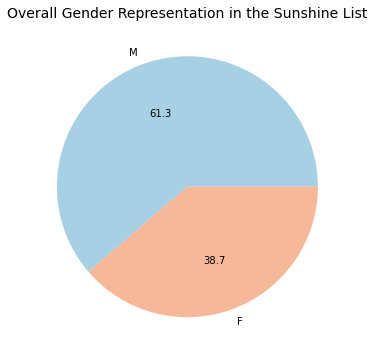

In [32]:
# Overall gender representation
plte = sns.color_palette("RdBu", 2)
plte.reverse()

plt.figure(figsize=(18, 6))
plt.title("Overall Gender Representation in the Sunshine List", size=14)
plt.axis('off')
df_sgr_full['Gender'].value_counts(normalize=True).plot(kind='pie', autopct="%.1f", colors=plte);

61.3% of the Sunshine List seem to be men, while 38.7% seem to be women. I have nothing else of value to say about this.

-----

## Change in gender representation over time

In [33]:
overall_rep = df_sgr_full.groupby(['Calendar Year', 'Gender']).size().reset_index(name='Count')

# overall_rep

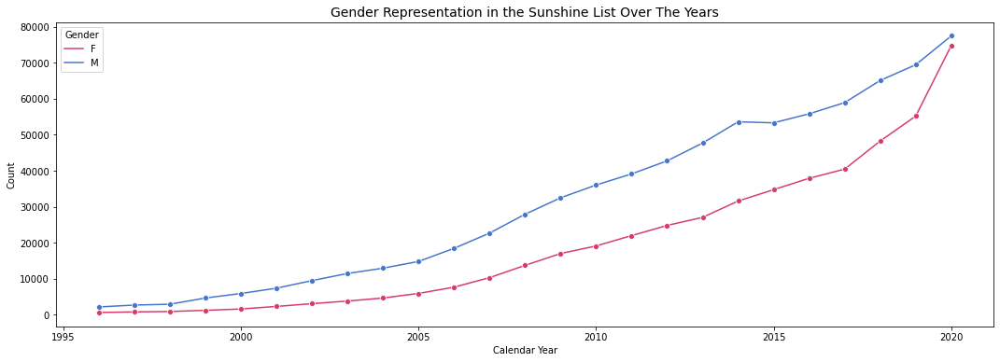

In [34]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Gender Representation in the Sunshine List Over The Years", size=14)
sns.lineplot(data=overall_rep, x='Calendar Year', y='Count', hue='Gender', marker='o');
plt.savefig('GenderYears.png', bbox_inches='tight');
plt.show();

There always tends to be more men compared to women in the list each year. The gap is closest between them in 1996 and 2020.

---

## Change in mean salary with gender over time

In [35]:
salary_rep = df_sgr_full.groupby(['Calendar Year', 'Gender'])[['Salary Paid']].mean().reset_index().rename(columns={'Salary Paid': 'Mean Salary'})

salary_rep

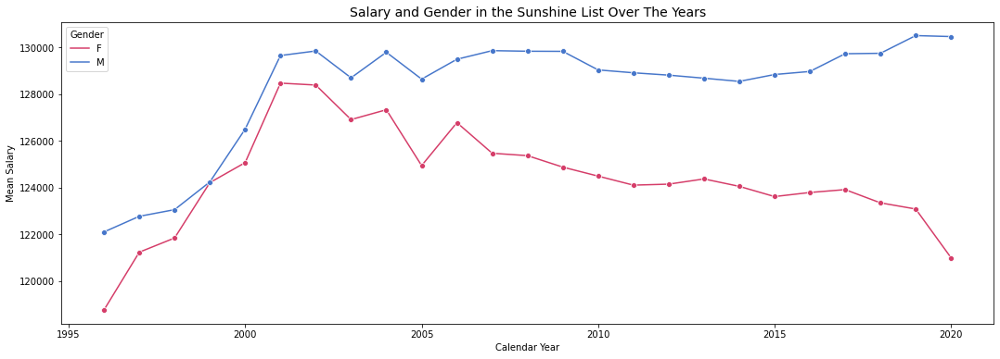

In [36]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Salary and Gender in the Sunshine List Over The Years", size=14)
sns.lineplot(data=salary_rep, x='Calendar Year', y='Mean Salary', hue='Gender', marker='o');
plt.savefig('SalaryYears.png', bbox_inches='tight');
plt.show();

Weirdly enough, after 2005, when the average dipped for both men and women, the average salary for women seemed to drop more, while the average salary for men seems to have increased.

-----

## Change in number and mean salary representation with gender in the largest and smallest sectors over time

In [37]:
smallest_sectors = []
largest_sectors = []
smallest_salaries = []
largest_salaries = []

for year in YEARS:
    counts_temp = df_sgr_full[df_sgr_full['Calendar Year'] == year].groupby(['Sector'])[['Salary Paid']].sum().sort_values('Salary Paid', ascending=False).reset_index()
    largest_sectors.append(counts_temp['Sector'].iloc[0])
    smallest_sectors.append(counts_temp['Sector'].iloc[-1])
    largest_salaries.append(counts_temp['Salary Paid'].iloc[0])
    smallest_salaries.append(counts_temp['Salary Paid'].iloc[-1])

In [38]:
df_sg_sectors = pd.DataFrame(data={'Year': YEARS, 'Smallest Sector': smallest_sectors, 'Largest Sector': largest_sectors})

# create dataframe with number of M/F people in smallest/largest sectors

df_ssv = {'Year': [], 'Gender': [], 'smallest': [], 'largest': []}
    
for year in YEARS:
    entry = df_sg_sectors.loc[df_sg_sectors['Year'] == year]
    for gender in ['M', 'F']:
        df_ssv['Year'].append(year)
        df_ssv['Gender'].append(gender)
        df_ssv['smallest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Gender'] == gender) & (df_sgr_full['Sector'] == entry.iloc[0]['Smallest Sector'])].shape[0]))
        df_ssv['largest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Gender'] == gender) & (df_sgr_full['Sector'] == entry.iloc[0]['Largest Sector'])].shape[0]))
    
df_ssv = pd.DataFrame(df_ssv)

In [39]:
df_ssv.set_index(['Year', 'Gender']);

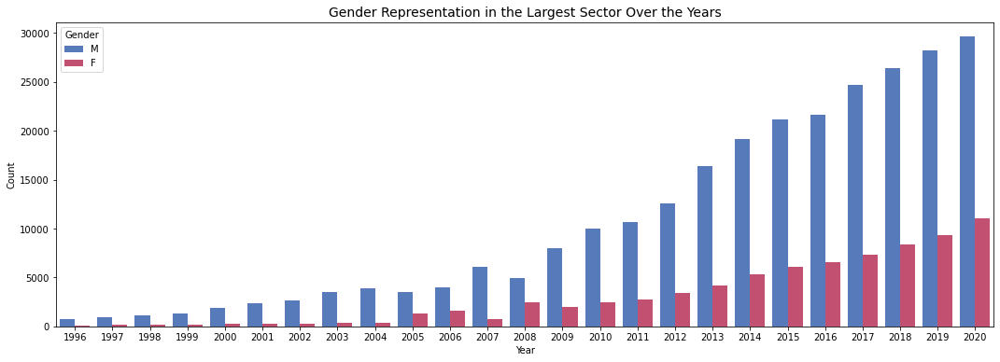

In [40]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(255, 0, sep=1, n=2)));
plt.title("Gender Representation in the Largest Sector Over the Years", size=14)

ax = sns.barplot(data=df_ssv, x='Year', y='largest', hue='Gender');
ax.set_ylabel("Count")
plt.savefig('GenderRepLargeYears.png', bbox_inches='tight');
plt.show();

After 2009, there seems to be a drastic increase in men in the largest sector, which widens the gap between them and women employees in the same sector.

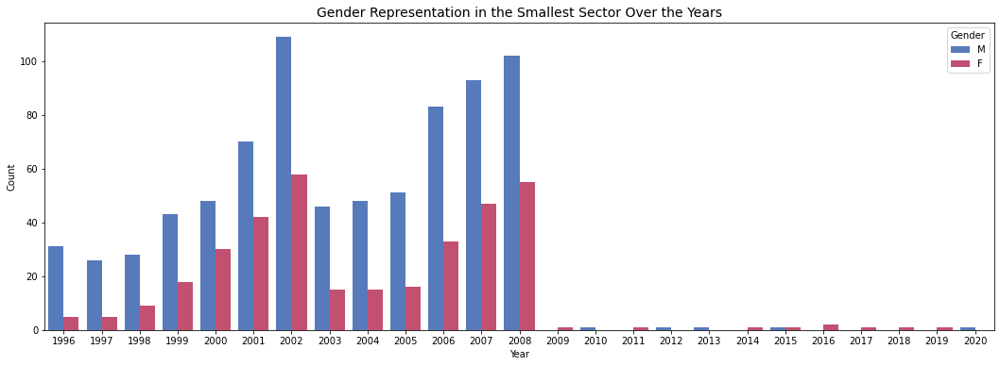

In [41]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(255, 0, sep=1, n=2)));
plt.title("Gender Representation in the Smallest Sector Over the Years", size=14)

ax2 = sns.barplot(data=df_ssv, x='Year', y='smallest', hue='Gender');
ax2.set_ylabel("Count")
plt.savefig('GenderRepSmallYears.png', bbox_inches='tight');
plt.show();

The smallest sectors for each year, if I recall correctly, tends to be a seconded sector (for employees that are temporarily in another position for that year). It seems that after 2008, this seconded sector wasn't needed as often, which is why the bars after that date have values close to, if not, 0.

In [42]:
df_ssv_mean = {'Year': [], 'Gender': [], 'smallest': [], 'largest': []}

# Create dataframe with mean salary of M/F workers in smallest/largest sector

for year in YEARS:
    entry = df_sg_sectors.loc[df_sg_sectors['Year'] == year]
    for gender in ['M', 'F']:
        df_ssv_mean['Year'].append(year)
        df_ssv_mean['Gender'].append(gender)
        df_ssv_mean['smallest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Gender'] == gender) & (df_sgr_full['Sector'] == entry.iloc[0]['Smallest Sector'])][['Salary Paid']].mean()))
        df_ssv_mean['largest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Gender'] == gender) & (df_sgr_full['Sector'] == entry.iloc[0]['Largest Sector'])][['Salary Paid']].mean()))
    
df_ssv_mean = pd.DataFrame(df_ssv_mean)

In [43]:
df_ssv_mean.set_index(['Year', 'Gender']).fillna(0);

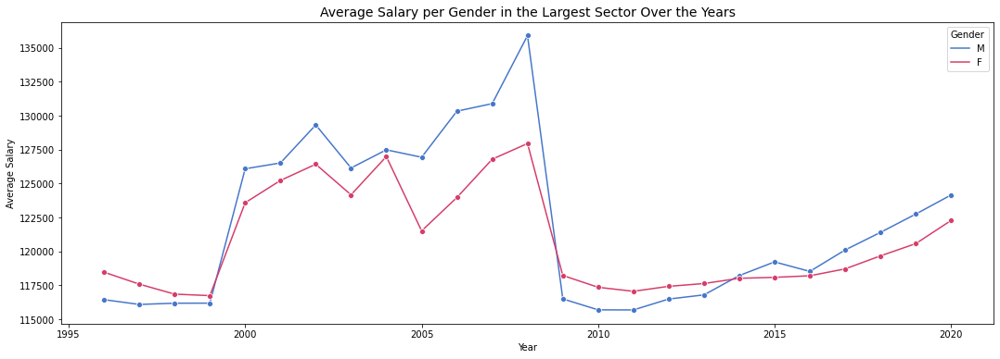

In [44]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(255, 0, sep=1, n=2)));
plt.title("Average Salary per Gender in the Largest Sector Over the Years", size=14)

ax3 = sns.lineplot(data=df_ssv_mean, x='Year', y='largest', hue='Gender', marker='o');
ax3.set_ylabel("Average Salary")
plt.savefig('AverageSalaryLargeYears.png', bbox_inches='tight');
plt.show();

The average salaries for both genders in the largest sector seem to follow the same trend. I found it surprising that women have a higher average salary than men from 1996-1999, and from 2009-2014.

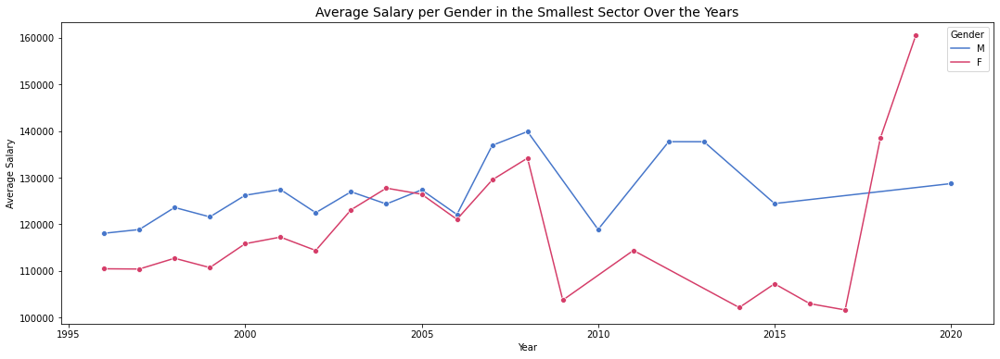

In [45]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(255, 0, sep=1, n=2)));
plt.title("Average Salary per Gender in the Smallest Sector Over the Years", size=14)

ax4 = sns.lineplot(data=df_ssv_mean, x='Year', y='smallest', hue='Gender', marker='o');
ax4.set_ylabel("Average Salary")
plt.savefig('AverageSalarySmallYears.png', bbox_inches='tight');
plt.show();

After 2017, the average salary for women in the smallest sector have increased, most likely because there could have been more women working in this seconded sector.

-----

## Gender representation and mean salary in the overall largest sector

In [46]:
# What's the sector that has paid the most overall?
top_sector = df_sgr_full.groupby(['Sector'])[['Salary Paid']].sum().sort_values('Salary Paid', ascending=False).reset_index().iloc[0]['Sector']

top_sector

'Municipalities'

In [47]:
# Create dataframe with mean/count of salaries

df_top_rep = df_sgr_full[df_sgr_full['Sector'] == top_sector].groupby(['Calendar Year', 'Gender'])[['Salary Paid']].count().rename(columns={'Salary Paid': 'Count'}).reset_index()
df_top_mean = df_sgr_full[df_sgr_full['Sector'] == top_sector].groupby(['Calendar Year', 'Gender'])[['Salary Paid']].mean().rename(columns={'Salary Paid': 'Average Salary'}).reset_index()

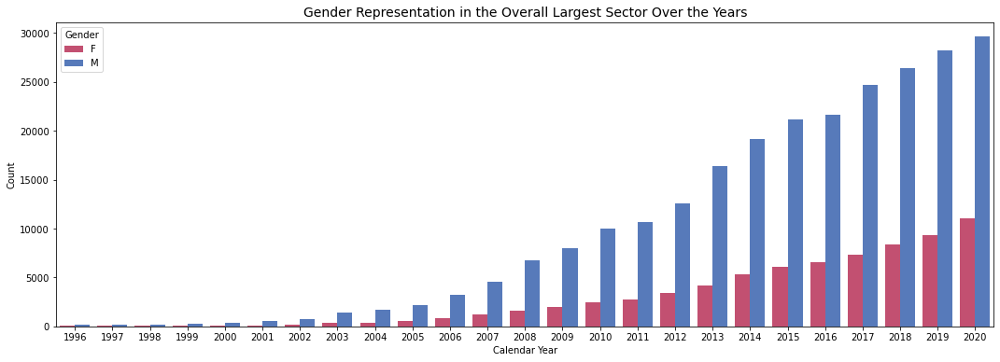

In [48]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Gender Representation in the Overall Largest Sector Over the Years", size=14)

ax5 = sns.barplot(data=df_top_rep, x='Calendar Year', y='Count', hue='Gender');
plt.savefig('GenderRepOverallLargeYears.png', bbox_inches='tight');
plt.show();

This sector was only the largest sector starting very recently (late 2000s). There is a very large growth in presumed male employees during that time as well, while the presumed female employees increase at a more linear rate.

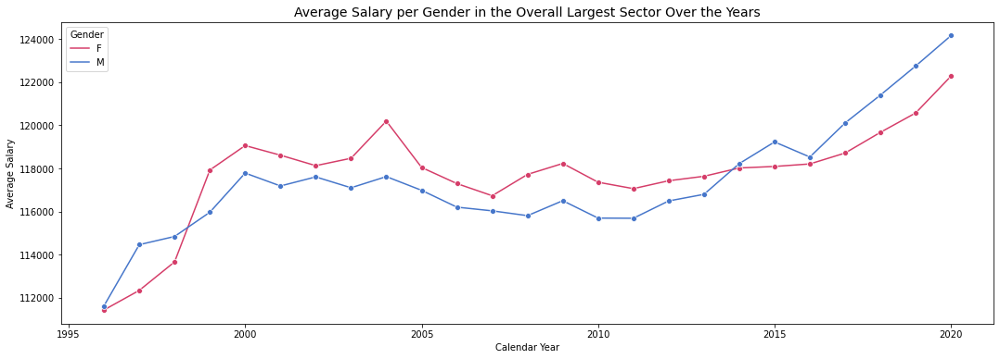

In [49]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Average Salary per Gender in the Overall Largest Sector Over the Years", size=14)

sns.lineplot(data=df_top_mean, x='Calendar Year', y='Average Salary', hue='Gender', marker='o');
plt.savefig('AverageSalaryOverallLargeYears.png', bbox_inches='tight');
plt.show();

Surprisingly, in this sector, women tend to have a higher average salary than men, but only until 2014.

---

## Section 4 - Race Representation

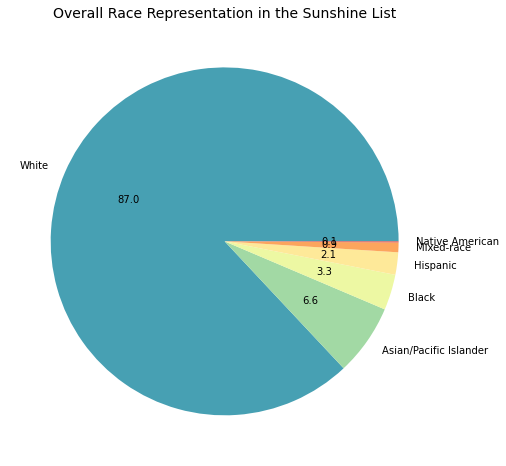

In [50]:
# Overall race representation
plte = sns.color_palette("Spectral", 6)
plte.reverse()

plt.figure(figsize=(20, 8))
plt.title("Overall Race Representation in the Sunshine List", size=14)
plt.axis('off')
df_sgr_full['Race'].value_counts(normalize=True).plot(kind='pie', autopct="%.1f", colors=plte);

The Sunshine List seems to be overwhelmingly white, which, for Ontario's public sectors, does not seem to be as diverse as the province itself.

-----

## Change in race representation over time

In [51]:
overall_gender_rep = df_sgr_full.groupby(['Calendar Year', 'Race']).size().reset_index(name='Count')
# overall_gender_rep

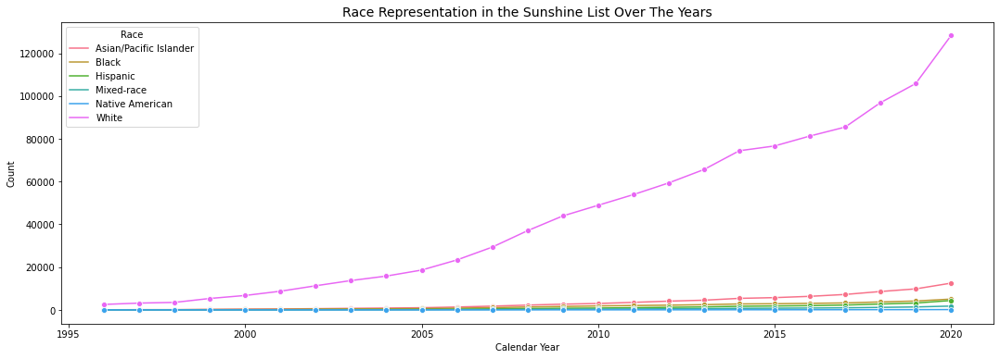

In [52]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Race Representation in the Sunshine List Over The Years", size=14)
sns.lineplot(data=overall_gender_rep, x='Calendar Year', y='Count', hue='Race', marker='o');
plt.savefig('RaceYears.png', bbox_inches='tight');
plt.show();

Again, there has been an increasing amount of (presumably) white people.

---

## Change in mean salary with race over time

In [53]:
salary_race_rep = df_sgr_full.groupby(['Calendar Year', 'Race'])[['Salary Paid']].mean().reset_index().rename(columns={'Salary Paid': 'Mean Salary'})

# salary_race_rep

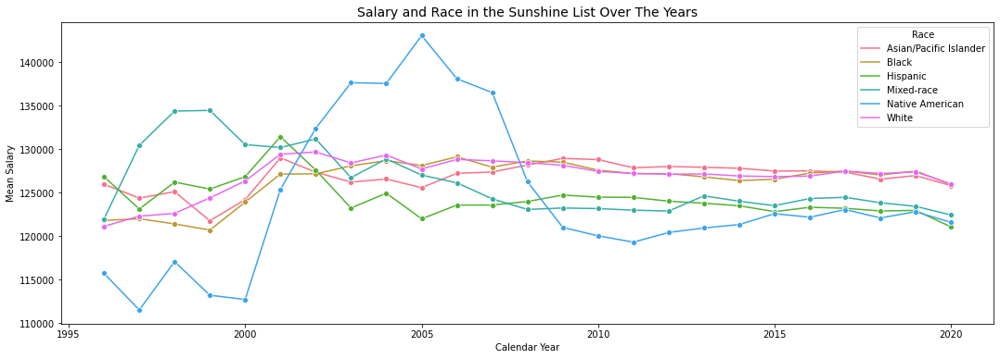

In [54]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Salary and Race in the Sunshine List Over The Years", size=14)
sns.lineplot(data=salary_race_rep, x='Calendar Year', y='Mean Salary', hue='Race', marker='o');
plt.savefig('SalaryYearsRace.png', bbox_inches='tight');
plt.show();

There seems to be a spike in which presumed Native Americans had the highest average salary (2002-2007). Apart from that, the average salary for presumed APL, white, and black people seem to be similar after 2010.

-----

## Change in number and mean salary representation with race in the largest and smallest sectors over time

In [55]:
df_ssr = {'Year': [], 'Race': [], 'smallest': [], 'largest': []}
    
for year in YEARS:
    entry = df_sg_sectors.loc[df_sg_sectors['Year'] == year]
    for race in ['White', 'Black', 'Asian/Pacific Islander', 'Native American', 'Mixed-race', 'Hispanic']:
        df_ssr['Year'].append(year)
        df_ssr['Race'].append(race)
        df_ssr['smallest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Race'] == race) & (df_sgr_full['Sector'] == entry.iloc[0]['Smallest Sector'])].shape[0]))
        df_ssr['largest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Race'] == race) & (df_sgr_full['Sector'] == entry.iloc[0]['Largest Sector'])].shape[0]))
    
df_ssr = pd.DataFrame(df_ssr)

In [56]:
df_ssr.set_index(['Year', 'Race']);

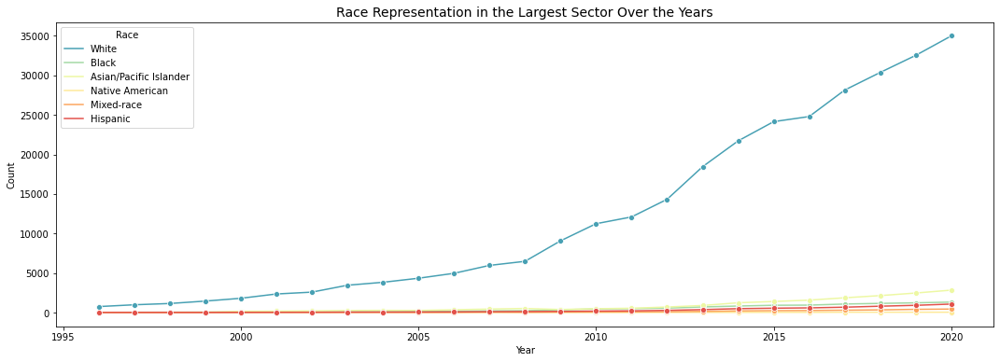

In [57]:
plt.figure(figsize=(18, 6))
sns.set_palette(plte);
plt.title("Race Representation in the Largest Sector Over the Years", size=14)

ax = sns.lineplot(data=df_ssr, x='Year', y='largest', hue='Race', marker='o');
ax.set_ylabel("Count")
plt.savefig('RaceRepLargeYears.png', bbox_inches='tight');
plt.show();

There are, again, a lot of white people in each largest sector. There is a slight increase in APL people after 2010, though.

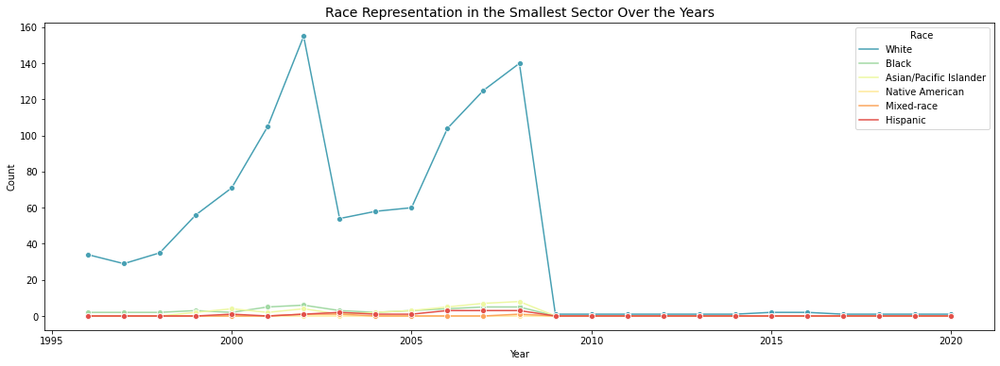

In [58]:
plt.figure(figsize=(18, 6))
sns.set_palette(plte);
plt.title("Race Representation in the Smallest Sector Over the Years", size=14)

ax2 = sns.lineplot(data=df_ssr, x='Year', y='smallest', hue='Race', marker='o');
ax2.set_ylabel("Count")
plt.savefig('RaceRepSmallYears.png', bbox_inches='tight');
plt.show();

The presumed low/0 values after 2009 have already been explained for the gender representation in the smallest sector - it's most likely because it's a seconded sector that nobody is needed in much lately.

In [59]:
df_ssr_mean = {'Year': [], 'Race': [], 'smallest': [], 'largest': []}
    
for year in YEARS:
    entry = df_sg_sectors.loc[df_sg_sectors['Year'] == year]
    for race in ['White', 'Black', 'Asian/Pacific Islander', 'Native American', 'Mixed-race', 'Hispanic']:
        df_ssr_mean['Year'].append(year)
        df_ssr_mean['Race'].append(race)
        df_ssr_mean['smallest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Race'] == race) & (df_sgr_full['Sector'] == entry.iloc[0]['Smallest Sector'])][['Salary Paid']].mean()))
        df_ssr_mean['largest'].append(float(df_sgr_full[(df_sgr_full['Calendar Year'] == year) & (df_sgr_full['Race'] == race) & (df_sgr_full['Sector'] == entry.iloc[0]['Largest Sector'])][['Salary Paid']].mean()))
    
df_ssr_mean = pd.DataFrame(df_ssr_mean)

In [60]:
df_ssr_mean.set_index(['Year', 'Race']).fillna(0);

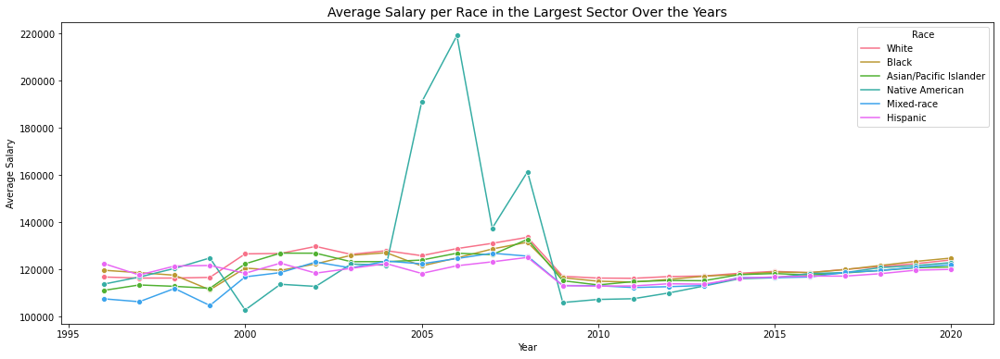

In [61]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(255, 0, sep=1, n=2)));
plt.title("Average Salary per Race in the Largest Sector Over the Years", size=14)

ax3 = sns.lineplot(data=df_ssr_mean, x='Year', y='largest', hue='Race', marker='o');
ax3.set_ylabel("Average Salary")
plt.savefig('AverageSalaryLargeYearsRace.png', bbox_inches='tight');
plt.show();

All the average salaries seem to be very similar to each other, until we notice the presumed Native American people having a high average salary for the top sectors from 2004 to 2008.

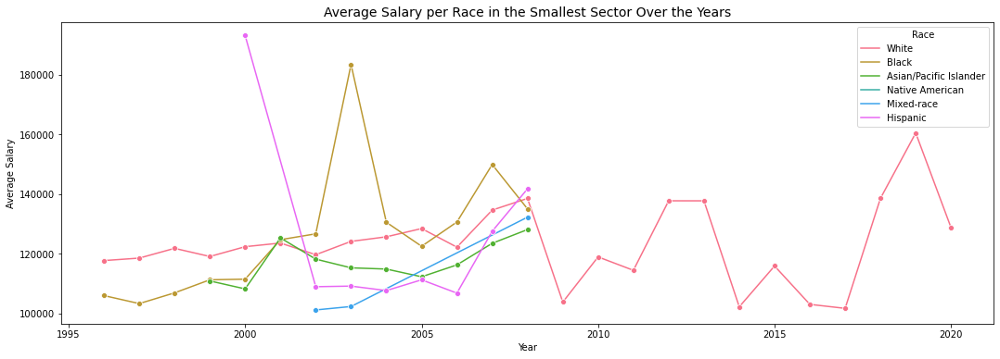

In [62]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(255, 0, sep=1, n=2)));
plt.title("Average Salary per Race in the Smallest Sector Over the Years", size=14)

ax4 = sns.lineplot(data=df_ssr_mean, x='Year', y='smallest', hue='Race', marker='o');
ax4.set_ylabel("Average Salary")
plt.savefig('AverageSalarySmallYearsRace.png', bbox_inches='tight');
plt.show();

I find it interesting that the line representing white people seems to be the only line with data for the smallest sector across every year.

-----

## Race representation and mean salary in the overall largest sector

In [63]:
# Create dataframe with mean/count of salaries

df_top_rep_r = df_sgr_full[df_sgr_full['Sector'] == top_sector].groupby(['Calendar Year', 'Race'])[['Salary Paid']].count().rename(columns={'Salary Paid': 'Count'}).reset_index()
df_top_mean_r = df_sgr_full[df_sgr_full['Sector'] == top_sector].groupby(['Calendar Year', 'Race'])[['Salary Paid']].mean().rename(columns={'Salary Paid': 'Average Salary'}).reset_index()

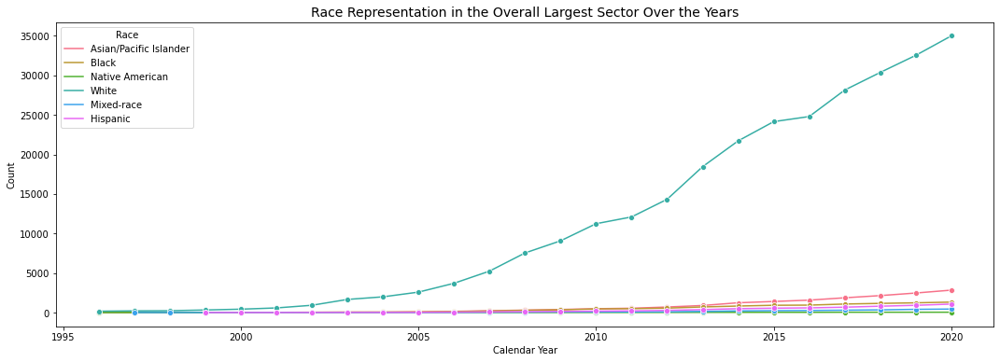

In [64]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Race Representation in the Overall Largest Sector Over the Years", size=14)

ax5 = sns.lineplot(data=df_top_rep_r, x='Calendar Year', y='Count', hue='Race', marker='o');
plt.savefig('GenderRepOverallLargeYears.png', bbox_inches='tight');
plt.show();

Again, there is an overwhelming increase in white people, followed by a slightly larger increase in presumed APL people, followed by a small increase in the rest.

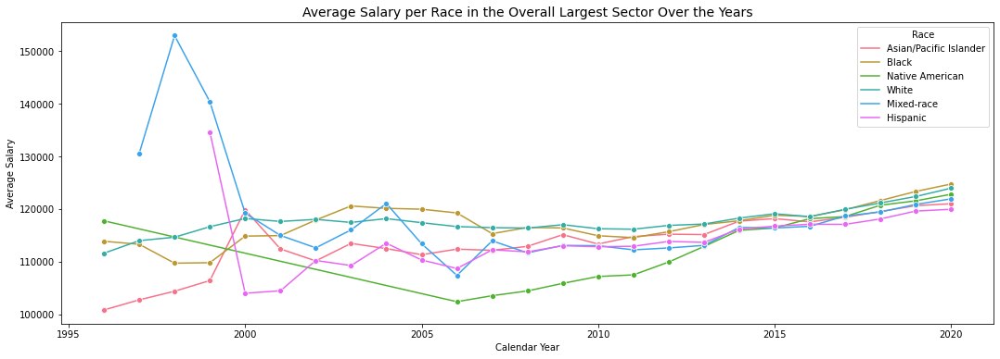

In [65]:
plt.figure(figsize=(18, 6))
sns.set_palette(sns.color_palette(sns.diverging_palette(0, 255, sep=1, n=2)));
plt.title("Average Salary per Race in the Overall Largest Sector Over the Years", size=14)

sns.lineplot(data=df_top_mean_r, x='Calendar Year', y='Average Salary', hue='Race', marker='o');
plt.savefig('AverageSalaryOverallLargeYearsRace.png', bbox_inches='tight');
plt.show();

Presumably, mixed-race people seem to have had very large average salaries in the overall largest sector before 2000. After that, it seems to even out and become similar, yet APL and Hispanic people tend to earn the least on average from 2015-2020.

---
---

---
---

# Potential Data Science

We wanted to point out any discrepancies in terms of race and gender in terms of the number of people in the Sunshine List, but this can be further extended, as a beginner data science project, to predicting the income of a person based on the sector they work in. We could also use this data to predict which public sectors would need more funding in the future based on trends from the past and present. We didn't touch much on the employer column of the Sunshine List, but if we did, we could probably predict how well a company is using their money based on how they pay their employers and finding any outliers in the salaries of their employers.

If there was a more accurate way of determining gender and race based on name, we could use data science to predict the rise or fall in representation of different ethnicities/genders. For a naive starter project though, we could extend the "predicting income based on sector" to take into account gender and race. 

---
---

# Conclusion

We were limited by the time we had, so we weren't able to clean the data enough for a proper analysis. As well, the misformatting and the encoding of the CSV files were a problem - one I had to fix by manually re-encoding each spreadsheet.